In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [1]:
import pandas as pd
import numpy as np
from datetime import datetime, timedelta

def generate_compressor_dataset(num_samples=100_000, decay_rates=None, noise_type='gaussian', correlation_factor=0.5, start_date='2023-01-01 00:00:00', sample_frequency='1T'):
    """
   Generate a real dataset for the SGT-400 compressor with additional sensors, random noise, decay patterns, and a time column.

    Parameters:
    - num_samples: Number of samples in the dataset.
    - decay_rates: Decay rates for the parameters (alphabetical).
    - noise_type: Noise type ('gaussian' or 'uniform').
    - correlation_factor: Correlation factor between sensors.
    - start_date: Start date of the time series (default: '2023-01-01 00:00:00').
    - sample_frequency: Sampling frequency (default: '1T' for one minute).
"""

  
    np.random.seed(42)  
    time_steps = np.arange(num_samples)

    flow_rate = np.random.uniform(100, 1000, num_samples)  # m³/min
    pressure_ratio = np.random.uniform(2, 15, num_samples)  # Ratio
    inlet_temperature = np.random.uniform(15, 30, num_samples)  # °C
    discharge_pressure = np.random.uniform(5, 100, num_samples)  # bar
    efficiency = np.random.uniform(75, 90, num_samples)  # %
    speed = np.random.uniform(3000, 12000, num_samples)  # RPM
    vibration = np.random.normal(loc=0.5, scale=0.1, size=num_samples)  # mm/s
    oil_pressure = np.random.uniform(2, 8, num_samples)  # bar

   
    sensors_data = {
        'Coolant_Temperature': np.random.uniform(60, 90, num_samples),  # °C
        'Fuel_Consumption': np.random.uniform(10, 50, num_samples),  # kg/h
        'Exhaust_Gas_Temperature': np.random.uniform(100, 200, num_samples),  # °C
        **{f"Sensor_{i+1}": np.random.uniform(0, 100, num_samples) for i in range(20)}   # 20 
    }

  
    data = {
        'Flow_Rate': flow_rate,
        'Pressure_Ratio': pressure_ratio,
        'Inlet_Temperature': inlet_temperature,
        'Discharge_Pressure': discharge_pressure,
        'Efficiency': efficiency,
        'Speed': speed,
        'Vibration': vibration,
        'Oil_Pressure': oil_pressure,
        **sensors_data  
    }

  
    def add_noise(values, noise_type='gaussian', std_factor=0.05):
        if noise_type == 'gaussian':
            return values + np.random.normal(0, std_factor * np.std(values), num_samples)
        elif noise_type == 'uniform':
            return values + np.random.uniform(-std_factor * np.std(values), std_factor * np.std(values), num_samples)
        else:
            raise ValueError("Invalid noise type. Use 'gaussian' or 'uniform'.")

    for key in data.keys():
        if key not in ['Label', 'RUL']:
            data[key] = add_noise(data[key], noise_type=noise_type)


    correlated_sensors = ['Flow_Rate', 'Pressure_Ratio', 'Efficiency']
    for sensor in correlated_sensors:
        for other_sensor in correlated_sensors:
            if sensor != other_sensor:
                data[sensor] += correlation_factor * (data[other_sensor] - np.mean(data[other_sensor]))


    start_datetime = datetime.strptime(start_date, '%Y-%m-%d %H:%M:%S')
    timestamps = [start_datetime + timedelta(minutes=i) for i in range(num_samples)]
    data['Timestamp'] = timestamps


    if decay_rates is None:
        decay_rates = {
            'Flow_Rate': 0.001,
            'Pressure_Ratio': 0.0005,
            'Efficiency': 0.0002,
            'Vibration': 0.0001,
            'Oil_Pressure': 0.0003,
            'Coolant_Temperature': 0.0004,
            'Fuel_Consumption': 0.0001,
            'Exhaust_Gas_Temperature': 0.0005
        }

    def exponential_decay(time_steps, initial_value, decay_rate):
        return initial_value * np.exp(-decay_rate * time_steps)

    for param, decay_rate in decay_rates.items():
        if param in data:
            data[param] -= exponential_decay(time_steps, data[param][0], decay_rate)

    # تعریف وضعیت (Label) بر اساس شرایط خرابی
    labels = []
    rul = []  # RUL (Remaining Useful Life)

    current_rul = num_samples  # RUL اولیه
    for i in range(num_samples):
        # شرایط خرابی
        is_failure = (
            (flow_rate[i] < 250 or flow_rate[i] > 750) or
            (pressure_ratio[i] < 4 or pressure_ratio[i] > 10) or
            (efficiency[i] < 75) or
            (speed[i] < 5000 or speed[i] > 10000) or
            (inlet_temperature[i] < 18 or inlet_temperature[i] > 25) or
            (vibration[i] > 1.0) or
            (oil_pressure[i] < 3 or oil_pressure[i] > 6) or
            (data['Coolant_Temperature'][i] < 65 or data['Coolant_Temperature'][i] > 85) or
            (data['Fuel_Consumption'][i] < 15 or data['Fuel_Consumption'][i] > 45) or
            (data['Exhaust_Gas_Temperature'][i] < 120 or data['Exhaust_Gas_Temperature'][i] > 180)
        )

        # تعیین وضعیت
        labels.append(0 if is_failure else 1)  # 0 = خراب، 1 = سالم

        # محاسبه RUL
        if is_failure:
            current_rul -= 1
        rul.append(current_rul)

    # اضافه کردن ستون‌های Label و RUL به دیتاست
    data['Label'] = labels
    data['RUL'] = rul

    # ایجاد DataFrame
    df = pd.DataFrame(data)

    return df




dataset = generate_compressor_dataset(
     num_samples=100_000,  # تعداد نمونه‌ها
     decay_rates={
            'Flow_Rate': 0.001,
            'Pressure_Ratio': 0.0005,
            'Efficiency': 0.0002,
            'Vibration': 0.0001,
            'Oil_Pressure': 0.0003,
            'Coolant_Temperature': 0.0004,
            'Fuel_Consumption': 0.0001,
            'Exhaust_Gas_Temperature': 0.0005
        },
        noise_type='gaussian',  # نوع نویز
        correlation_factor=0.3,  # فاکتور همبستگی
        start_date='2023-01-01 00:00:00',  # تاریخ شروع
        sample_frequency='1T'  # فرکانس نمونه‌برداری (1T = یک دقیقه)
    )

    # ذخیره دیتاست به فایل CSV
output_file = 'compressor_dataset_realistic_with_timestamp.csv'
dataset.to_csv(output_file, index=False)
print(f"Dataset with {len(dataset)} samples generated successfully and saved to '{output_file}'.")

Dataset with 100000 samples generated successfully and saved to 'compressor_dataset_realistic_with_timestamp.csv'.


In [5]:
import pandas as pd

df = pd.read_csv('compressor_dataset_realistic_with_timestamp.csv')

print(df.head())

    Flow_Rate  Pressure_Ratio  Inlet_Temperature  Discharge_Pressure  \
0    0.000000        0.000000          19.222124           18.900369   
1  495.737854      145.212458          21.961369           14.444214   
2  295.011340       81.555963          16.286223           19.258378   
3  176.517556       51.242674          21.731543           49.855437   
4 -241.230161      -77.782572          18.183541           88.321024   

   Efficiency         Speed  Vibration  Oil_Pressure  Coolant_Temperature  \
0    0.000000   5792.627051   0.000000      0.000000             0.000000   
1  183.658407   7784.070207   0.083525      0.744314            -0.967682   
2  100.516628   8846.427037  -0.001917      1.658273           -16.496520   
3   68.792543  11586.645555  -0.105635      2.876124            -7.924154   
4 -102.717674   9286.361803  -0.055190      2.352585            -1.052788   

   Fuel_Consumption  ...  Sensor_14  Sensor_15  Sensor_16  Sensor_17  \
0          0.000000  ...  46.393

In [4]:
import pandas as pd

df = pd.read_csv('compressor_dataset_realistic_with_timestamp.csv')


print("Column Names:", df.columns.tolist())

print(df.head())


Column Names: ['Flow_Rate', 'Pressure_Ratio', 'Inlet_Temperature', 'Discharge_Pressure', 'Efficiency', 'Speed', 'Vibration', 'Oil_Pressure', 'Coolant_Temperature', 'Fuel_Consumption', 'Exhaust_Gas_Temperature', 'Sensor_1', 'Sensor_2', 'Sensor_3', 'Sensor_4', 'Sensor_5', 'Sensor_6', 'Sensor_7', 'Sensor_8', 'Sensor_9', 'Sensor_10', 'Sensor_11', 'Sensor_12', 'Sensor_13', 'Sensor_14', 'Sensor_15', 'Sensor_16', 'Sensor_17', 'Sensor_18', 'Sensor_19', 'Sensor_20', 'Timestamp', 'Label', 'RUL']
    Flow_Rate  Pressure_Ratio  Inlet_Temperature  Discharge_Pressure  \
0    0.000000        0.000000          19.222124           18.900369   
1  495.737854      145.212458          21.961369           14.444214   
2  295.011340       81.555963          16.286223           19.258378   
3  176.517556       51.242674          21.731543           49.855437   
4 -241.230161      -77.782572          18.183541           88.321024   

   Efficiency         Speed  Vibration  Oil_Pressure  Coolant_Temperature  \


📌 **نتایج آزمون Shapiro-Wilk برای نرمال بودن متغیرها:**
Flow_Rate: p-value = 0.00000 → ❌ غیرنرمال
Pressure_Ratio: p-value = 0.00000 → ❌ غیرنرمال
Inlet_Temperature: p-value = 0.00000 → ❌ غیرنرمال
Discharge_Pressure: p-value = 0.00000 → ❌ غیرنرمال
Efficiency: p-value = 0.00000 → ❌ غیرنرمال
Speed: p-value = 0.00000 → ❌ غیرنرمال
Vibration: p-value = 0.00000 → ❌ غیرنرمال
Oil_Pressure: p-value = 0.00000 → ❌ غیرنرمال
Coolant_Temperature: p-value = 0.00000 → ❌ غیرنرمال
Fuel_Consumption: p-value = 0.00000 → ❌ غیرنرمال
Exhaust_Gas_Temperature: p-value = 0.00000 → ❌ غیرنرمال
Sensor_1: p-value = 0.00000 → ❌ غیرنرمال
Sensor_2: p-value = 0.00000 → ❌ غیرنرمال
Sensor_3: p-value = 0.00000 → ❌ غیرنرمال
Sensor_4: p-value = 0.00000 → ❌ غیرنرمال
Sensor_5: p-value = 0.00000 → ❌ غیرنرمال
Sensor_6: p-value = 0.00000 → ❌ غیرنرمال
Sensor_7: p-value = 0.00000 → ❌ غیرنرمال
Sensor_8: p-value = 0.00000 → ❌ غیرنرمال
Sensor_9: p-value = 0.00000 → ❌ غیرنرمال
Sensor_10: p-value = 0.00000 → ❌ غیرنرمال
Sensor_11: p-valu

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  

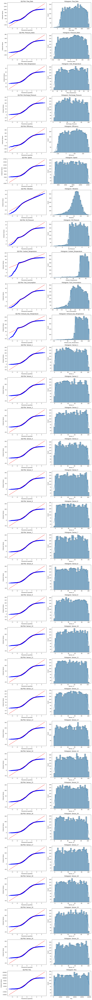

In [5]:
import pandas as pd
import numpy as np
import scipy.stats as stats
import matplotlib.pyplot as plt
import seaborn as sns

# Load dataset
df = pd.read_csv("/kaggle/working/compressor_dataset_realistic_with_timestamp.csv")

# Excluded columns and selection of numeric columns
excluded_columns = ['Label', 'Timestamp']
numeric_columns = [col for col in df.columns if col not in excluded_columns and df[col].dtype in ['int64', 'float64']]

# Define sample size for the test
sample_size = min(5000, len(df))  

# Store Shapiro-Wilk test results
shapiro_results = {}

# Run Shapiro-Wilk test on each variable
for col in numeric_columns:
    sample = df[col].sample(sample_size, random_state=42)  # Random sampling
    stat, p = stats.shapiro(sample)  # Perform Shapiro-Wilk test
    
    # Store result
    shapiro_results[col] = p

# Print results
print("\n📌 **Shapiro-Wilk Test Results for Normality of Variables:**")
for col, p in shapiro_results.items():
    result = "✅ Normal" if p > 0.05 else "❌ Not Normal"
    print(f"{col}: p-value = {p:.5f} → {result}")

# Create QQ-Plot and Histogram for each variable
num_plots = len(numeric_columns)
fig, axes = plt.subplots(num_plots, 2, figsize=(12, 4*num_plots))

for i, col in enumerate(numeric_columns):
    sample = df[col].sample(sample_size, random_state=42)

    # QQ-Plot
    stats.probplot(sample, dist="norm", plot=axes[i, 0])
    axes[i, 0].set_title(f"QQ-Plot: {col}")

    # Histogram
    sns.histplot(sample, kde=True, ax=axes[i, 1], bins=30)
    axes[i, 1].set_title(f"Histogram: {col}")

plt.tight_layout()
plt.show()


# Shapiro-Wilk  & Kolmogorov-Smirnov test with QQ-Plot and Histogram


📌 **نتایج آزمون Shapiro-Wilk برای نرمال بودن متغیرها:**
Flow_Rate: p-value = 0.00000 → ❌ غیرنرمال
Pressure_Ratio: p-value = 0.00000 → ❌ غیرنرمال
Inlet_Temperature: p-value = 0.00000 → ❌ غیرنرمال
Discharge_Pressure: p-value = 0.00000 → ❌ غیرنرمال
Efficiency: p-value = 0.00000 → ❌ غیرنرمال
Speed: p-value = 0.00000 → ❌ غیرنرمال
Vibration: p-value = 0.00000 → ❌ غیرنرمال
Oil_Pressure: p-value = 0.00000 → ❌ غیرنرمال
Coolant_Temperature: p-value = 0.00000 → ❌ غیرنرمال
Fuel_Consumption: p-value = 0.00000 → ❌ غیرنرمال
Exhaust_Gas_Temperature: p-value = 0.00000 → ❌ غیرنرمال
Sensor_1: p-value = 0.00000 → ❌ غیرنرمال
Sensor_2: p-value = 0.00000 → ❌ غیرنرمال
Sensor_3: p-value = 0.00000 → ❌ غیرنرمال
Sensor_4: p-value = 0.00000 → ❌ غیرنرمال
Sensor_5: p-value = 0.00000 → ❌ غیرنرمال
Sensor_6: p-value = 0.00000 → ❌ غیرنرمال
Sensor_7: p-value = 0.00000 → ❌ غیرنرمال
Sensor_8: p-value = 0.00000 → ❌ غیرنرمال
Sensor_9: p-value = 0.00000 → ❌ غیرنرمال
Sensor_10: p-value = 0.00000 → ❌ غیرنرمال
Sensor_11: p-valu

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  

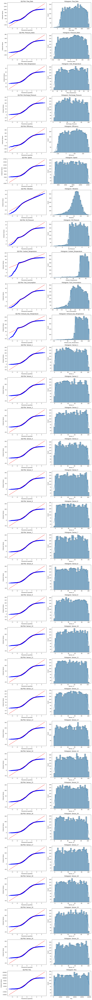

In [6]:
import pandas as pd
import numpy as np
import scipy.stats as stats
import matplotlib.pyplot as plt
import seaborn as sns

# Read the dataset
df = pd.read_csv("/kaggle/working/compressor_dataset_realistic_with_timestamp.csv")

# Exclude non-numeric columns
excluded_columns = ['Label', 'Timestamp']
numeric_columns = [col for col in df.columns if col not in excluded_columns and df[col].dtype in ['int64', 'float64']]

# Define sample size for the test
sample_size = min(5000, len(df))  

# Store test results
shapiro_results = {}
ks_results = {}

# Perform Shapiro-Wilk and Kolmogorov-Smirnov tests for each variable
for col in numeric_columns:
    sample = df[col].sample(sample_size, random_state=42)  # Random sampling
    
    # Shapiro-Wilk test
    stat, p_shapiro = stats.shapiro(sample)  # Perform Shapiro-Wilk test
    shapiro_results[col] = p_shapiro
    
    # Kolmogorov-Smirnov test
    stat_ks, p_ks = stats.kstest(sample, 'norm')  # Perform Kolmogorov-Smirnov test with normal distribution
    ks_results[col] = p_ks

# Print results for Shapiro-Wilk test
print("\n📌 **Shapiro-Wilk Test Results for Normality of Variables:**")
for col, p in shapiro_results.items():
    result = "✅ Normal" if p > 0.05 else "❌ Not Normal"
    print(f"{col}: p-value = {p:.5f} → {result}")

# Print results for Kolmogorov-Smirnov test
print("\n📌 **Kolmogorov-Smirnov Test Results for Normality of Variables:**")
for col, p in ks_results.items():
    result = "✅ Normal" if p > 0.05 else "❌ Not Normal"
    print(f"{col}: p-value = {p:.5f} → {result}")

# Create QQ-Plot and Histogram for each variable
num_plots = len(numeric_columns)
fig, axes = plt.subplots(num_plots, 2, figsize=(12, 4*num_plots))

for i, col in enumerate(numeric_columns):
    sample = df[col].sample(sample_size, random_state=42)

    # QQ-Plot 
    stats.probplot(sample, dist="norm", plot=axes[i, 0])
    axes[i, 0].set_title(f"QQ-Plot: {col}")

    # Histogram
    sns.histplot(sample, kde=True, ax=axes[i, 1], bins=30)
    axes[i, 1].set_title(f"Histogram: {col}")

plt.tight_layout()
plt.show()


# Skewness & Kurtosis data with Histogram and Boxplot for Kurtosis


📌 **نتایج محاسبه Skewness (چولگی) برای متغیرها:**
Flow_Rate: Skewness = -0.05535 → چپ‌چین
Pressure_Ratio: Skewness = -0.04691 → چپ‌چین
Inlet_Temperature: Skewness = -0.03447 → چپ‌چین
Discharge_Pressure: Skewness = 0.03076 → راست‌چین
Efficiency: Skewness = -0.04920 → چپ‌چین
Speed: Skewness = 0.00863 → راست‌چین
Vibration: Skewness = -0.89672 → چپ‌چین
Oil_Pressure: Skewness = -0.24871 → چپ‌چین
Coolant_Temperature: Skewness = -2.24719 → چپ‌چین
Fuel_Consumption: Skewness = -0.44928 → چپ‌چین
Exhaust_Gas_Temperature: Skewness = -0.74405 → چپ‌چین
Sensor_1: Skewness = 0.04219 → راست‌چین
Sensor_2: Skewness = 0.01849 → راست‌چین
Sensor_3: Skewness = -0.02713 → چپ‌چین
Sensor_4: Skewness = 0.00460 → راست‌چین
Sensor_5: Skewness = -0.00579 → چپ‌چین
Sensor_6: Skewness = 0.02797 → راست‌چین
Sensor_7: Skewness = -0.01036 → چپ‌چین
Sensor_8: Skewness = -0.00840 → چپ‌چین
Sensor_9: Skewness = 0.01053 → راست‌چین
Sensor_10: Skewness = -0.02109 → چپ‌چین
Sensor_11: Skewness = 0.02536 → راست‌چین
Sensor_12: Skewne

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  

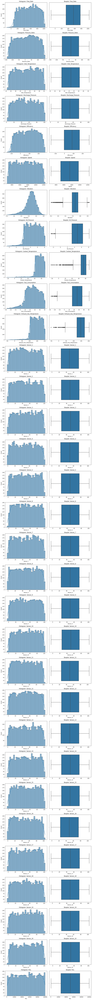

In [7]:
import pandas as pd
import numpy as np
import scipy.stats as stats
import matplotlib.pyplot as plt
import seaborn as sns

# Read the dataset
df = pd.read_csv("/kaggle/working/compressor_dataset_realistic_with_timestamp.csv")

# Exclude non-numeric columns
excluded_columns = ['Label', 'Timestamp']
numeric_columns = [col for col in df.columns if col not in excluded_columns and df[col].dtype in ['int64', 'float64']]

# Define sample size for each test
sample_size = min(5000, len(df))

# Store Skewness and Kurtosis results
skewness_results = {}
kurtosis_results = {}

# Compute Skewness and Kurtosis for each numeric column
for col in numeric_columns:
    sample = df[col].sample(sample_size, random_state=42)  # Random sampling
    
    # Calculate Skewness
    skew = stats.skew(sample)
    skewness_results[col] = skew
    
    # Calculate Kurtosis
    kurt = stats.kurtosis(sample)
    kurtosis_results[col] = kurt

# Print Skewness results
print("\n📌 **Skewness Calculation Results for Variables:**")
for col, skew in skewness_results.items():
    result = "Right-Skewed" if skew > 0 else "Left-Skewed" if skew < 0 else "Symmetric"
    print(f"{col}: Skewness = {skew:.5f} → {result}")

# Print Kurtosis results
print("\n📌 **Kurtosis Calculation Results for Variables:**")
for col, kurt in kurtosis_results.items():
    result = "Platykurtic" if kurt < 3 else "Leptokurtic" if kurt > 3 else "Mesokurtic"
    print(f"{col}: Kurtosis = {kurt:.5f} → {result}")

# Create plots for each variable
num_plots = len(numeric_columns)
fig, axes = plt.subplots(num_plots, 2, figsize=(12, 4*num_plots))

for i, col in enumerate(numeric_columns):
    sample = df[col].sample(sample_size, random_state=42)

    # Histogram 
    sns.histplot(sample, kde=True, ax=axes[i, 0], bins=30)
    axes[i, 0].set_title(f"Histogram: {col}")

    # Boxplot for Kurtosis
    sns.boxplot(x=sample, ax=axes[i, 1])
    axes[i, 1].set_title(f"Boxplot: {col}")

plt.tight_layout()
plt.show()


# Anderson-Darling and arque-Bera Test

In [8]:
import pandas as pd
from scipy import stats
import numpy as np
import matplotlib.pyplot as plt

# Load the dataset
df = pd.read_csv('compressor_dataset_realistic_with_timestamp.csv')

# Columns of interest
columns = ['Flow_Rate', 'Pressure_Ratio', 'Inlet_Temperature', 'Discharge_Pressure', 'Efficiency', 'Speed', 'Vibration', 'Oil_Pressure', 'Coolant_Temperature', 'Fuel_Consumption', 
           'Exhaust_Gas_Temperature', 'Sensor_1', 'Sensor_2', 'Sensor_3', 'Sensor_4', 'Sensor_5', 'Sensor_6', 'Sensor_7', 'Sensor_8', 'Sensor_9', 'Sensor_10', 'Sensor_11', 
           'Sensor_12', 'Sensor_13', 'Sensor_14', 'Sensor_15', 'Sensor_16', 'Sensor_17', 'Sensor_18', 'Sensor_19', 'Sensor_20', 'RUL']

# Apply Jarque-Bera and Anderson-Darling tests for all columns except 'Label' and 'Timestamp'
results_jarque_bera = {}
results_anderson_darling = {}

for column in columns:
    # Jarque-Bera Test
    jb_stat, jb_p_value = stats.jarque_bera(df[column].dropna())  # Drop missing values
    results_jarque_bera[column] = jb_p_value
    
    # Anderson-Darling Test 
    ad_stat, ad_critical_values, ad_significance_level = stats.anderson(df[column].dropna(), dist='norm')
    results_anderson_darling[column] = ad_stat

# Results of the Jarque-Bera Test
print("Results of the Jarque-Bera Test (p-value):")
for column, p_value in results_jarque_bera.items():
    print(f"{column}: p-value = {p_value:.4f}")
    if p_value < 0.05:
        print(f"  => Data in {column} significantly deviate from normality (reject normality hypothesis).")
    else:
        print(f"  => Data in {column} follow a normal distribution (accept normality hypothesis).")

# Results of the Anderson-Darling Test
print("\nResults of the Anderson-Darling Test (Test Statistic):")
for column, ad_stat in results_anderson_darling.items():
    print(f"{column}: Statistic = {ad_stat:.4f}")
    if ad_stat > 2.5:  # Threshold based on typical significance level for Anderson-Darling
        print(f"  => Data in {column} significantly deviate from normality.")
    else:
        print(f"  => Data in {column} follow a normal distribution.")


نتایج آزمون Jarque-Bera (p-value):
Flow_Rate: p-value = 0.0000
  => داده‌های Flow_Rate از نرمال بودن فاصله دارند (رد فرضیه نرمال بودن).
Pressure_Ratio: p-value = 0.0000
  => داده‌های Pressure_Ratio از نرمال بودن فاصله دارند (رد فرضیه نرمال بودن).
Inlet_Temperature: p-value = 0.0000
  => داده‌های Inlet_Temperature از نرمال بودن فاصله دارند (رد فرضیه نرمال بودن).
Discharge_Pressure: p-value = 0.0000
  => داده‌های Discharge_Pressure از نرمال بودن فاصله دارند (رد فرضیه نرمال بودن).
Efficiency: p-value = 0.0000
  => داده‌های Efficiency از نرمال بودن فاصله دارند (رد فرضیه نرمال بودن).
Speed: p-value = 0.0000
  => داده‌های Speed از نرمال بودن فاصله دارند (رد فرضیه نرمال بودن).
Vibration: p-value = 0.0000
  => داده‌های Vibration از نرمال بودن فاصله دارند (رد فرضیه نرمال بودن).
Oil_Pressure: p-value = 0.0000
  => داده‌های Oil_Pressure از نرمال بودن فاصله دارند (رد فرضیه نرمال بودن).
Coolant_Temperature: p-value = 0.0000
  => داده‌های Coolant_Temperature از نرمال بودن فاصله دارند (رد فرضیه نرمال

Summary Statistics:
           Flow_Rate  Pressure_Ratio  Inlet_Temperature  Discharge_Pressure  \
count  100000.000000   100000.000000      100000.000000       100000.000000   
mean      544.849892        8.798863          22.507371           52.402563   
std       261.903778       78.072358           4.337966           27.454745   
min      -345.246666     -141.886700          14.388659            1.336858   
25%       319.973661      -58.653948          18.761226           28.650537   
50%       545.685649        8.842708          22.520825           52.295160   
75%       770.543169       76.336187          26.259948           76.198364   
max      1038.248762      162.045429          30.716435          103.669571   

          Efficiency          Speed      Vibration   Oil_Pressure  \
count  100000.000000  100000.000000  100000.000000  100000.000000   
mean       79.723934    7495.482373       0.450087       4.834307   
std       101.830608    2598.501638       0.141515       1.84

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


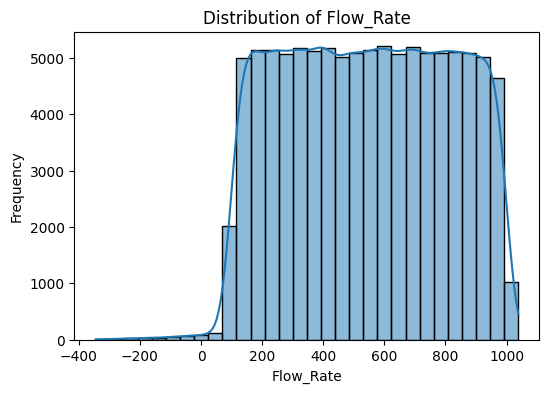

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


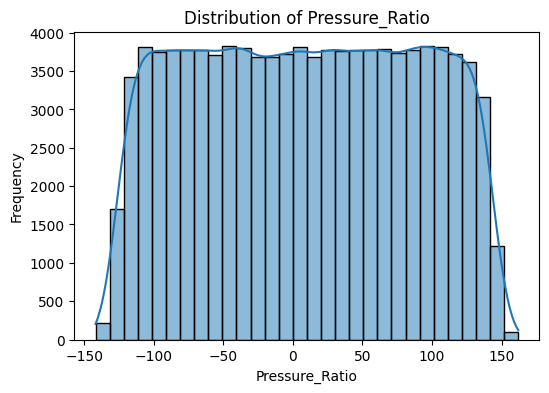

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


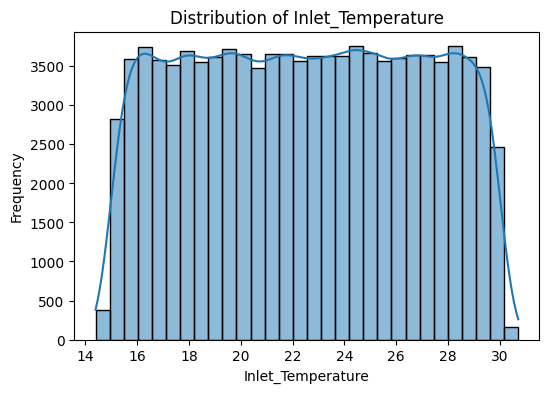

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


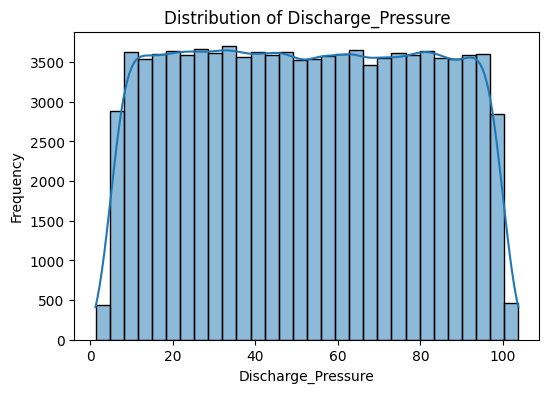

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


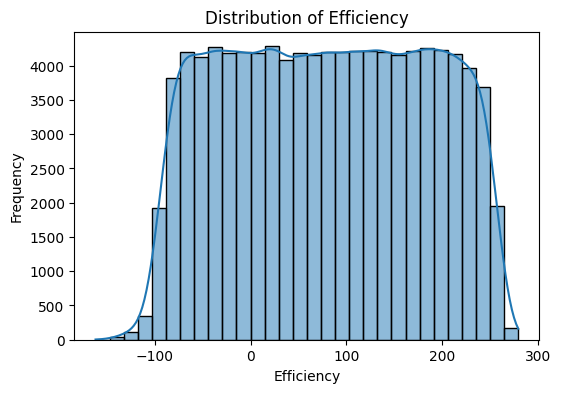

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


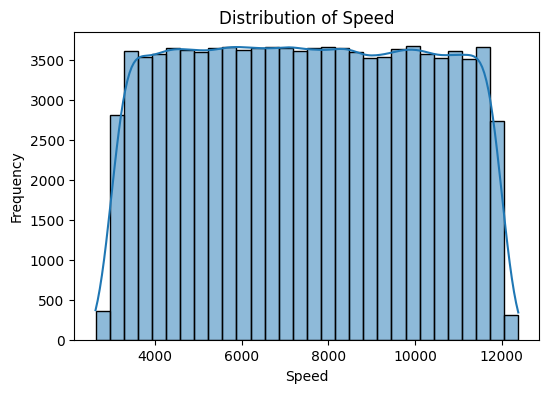

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


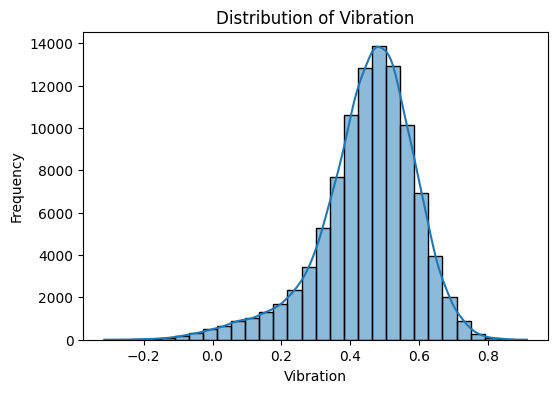

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


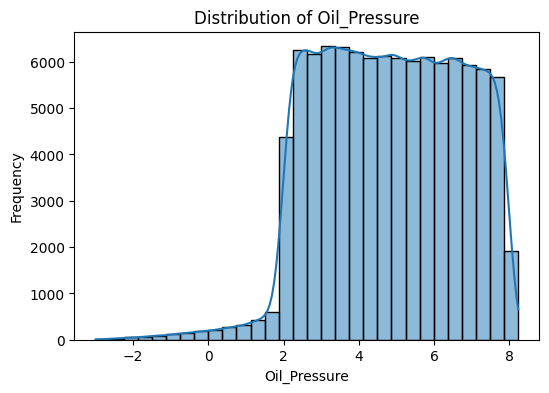

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


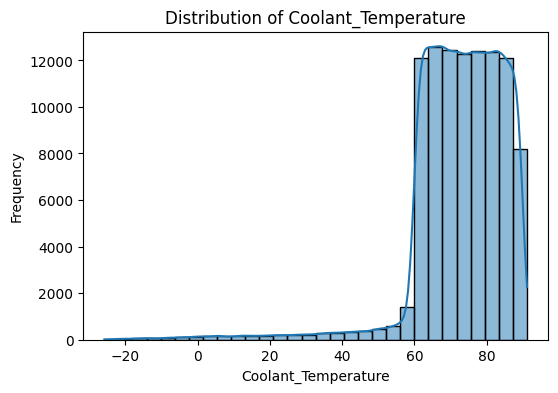

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


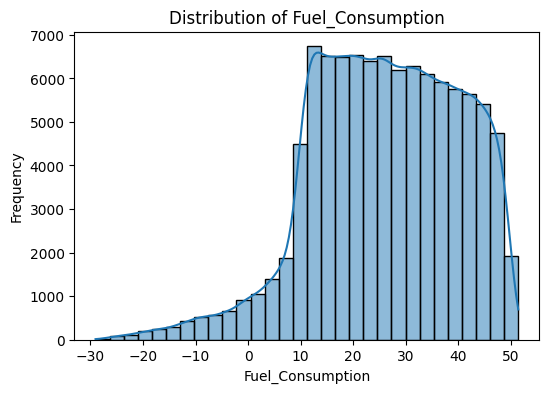

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


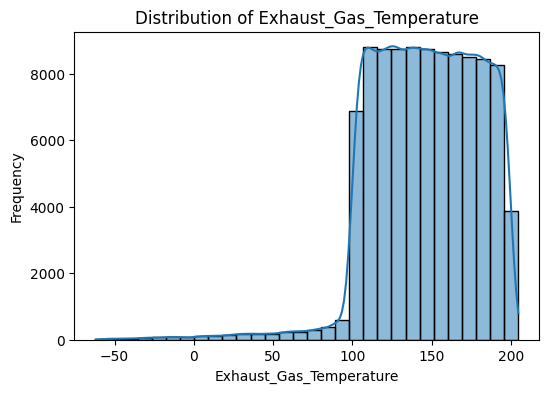

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


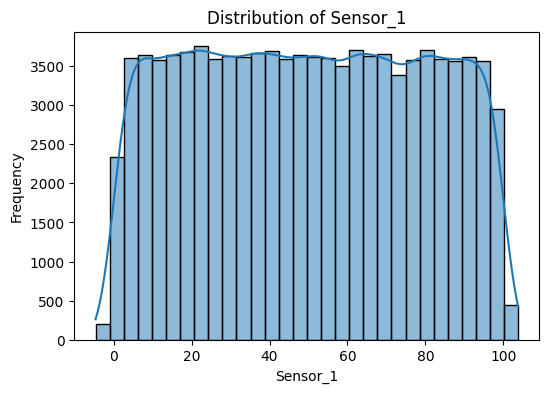

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


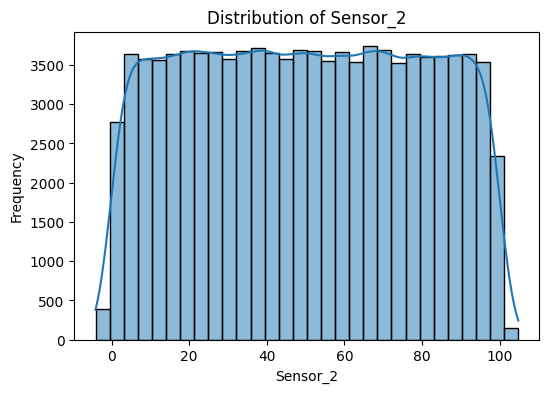

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


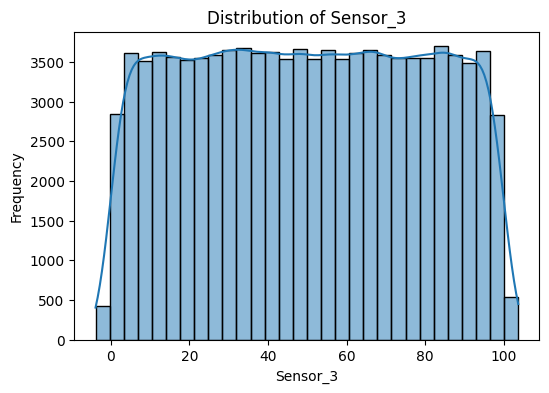

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


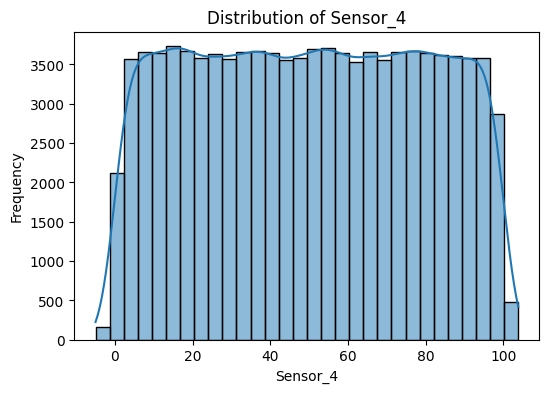

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


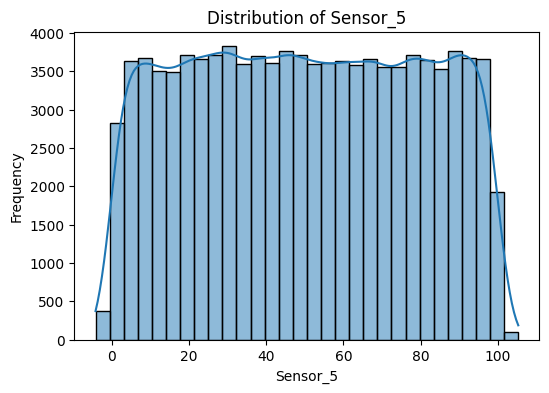

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


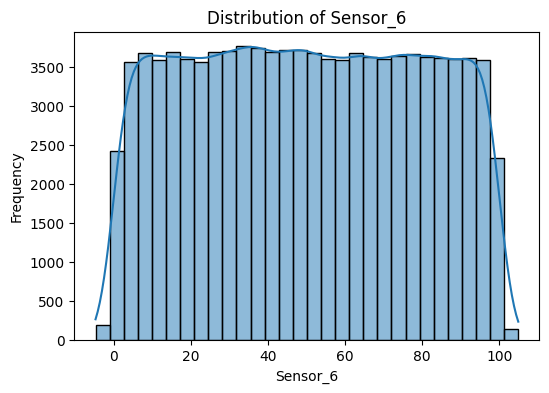

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


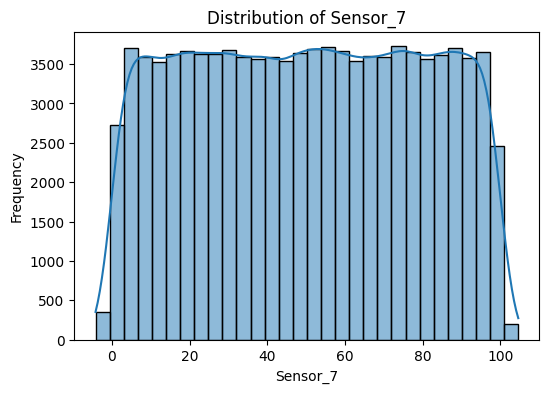

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


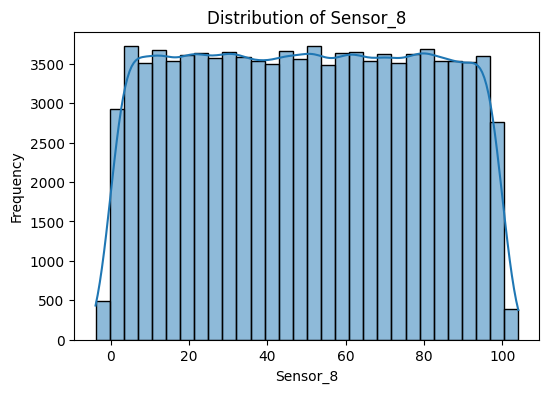

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


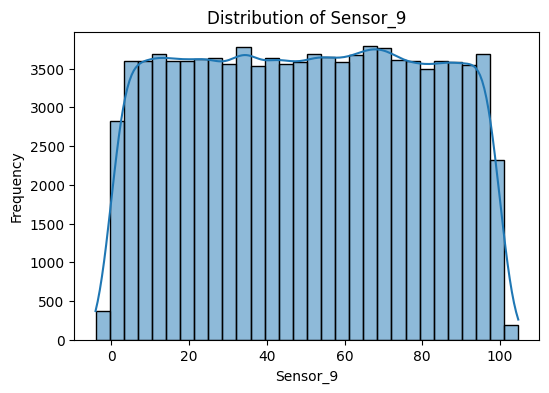

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


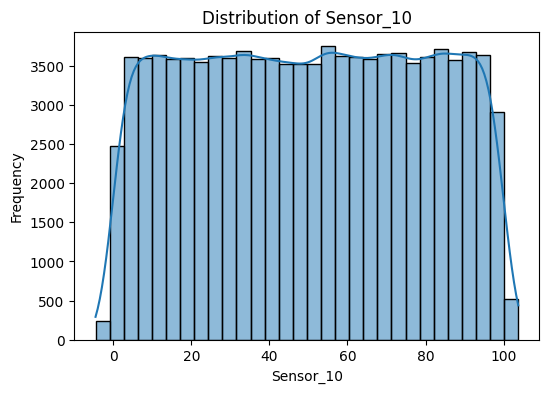

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


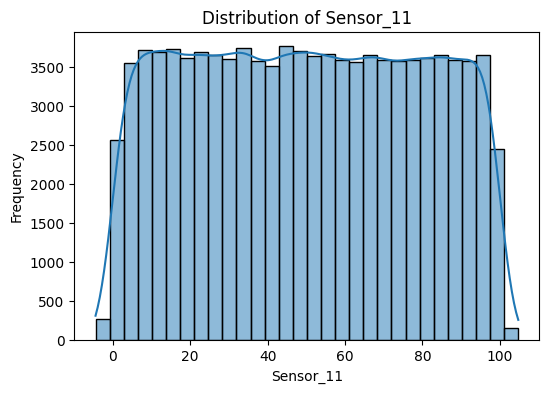

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


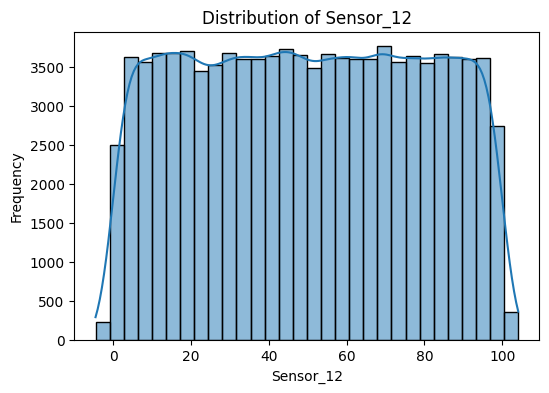

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


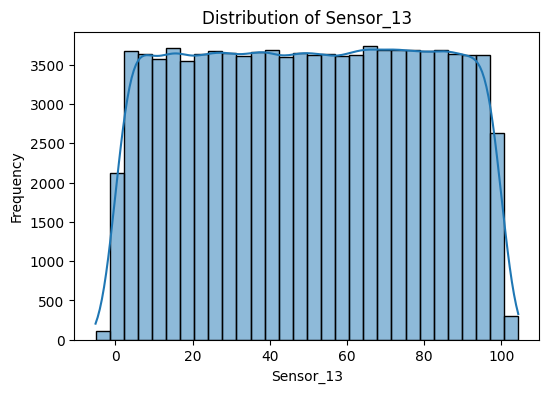

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


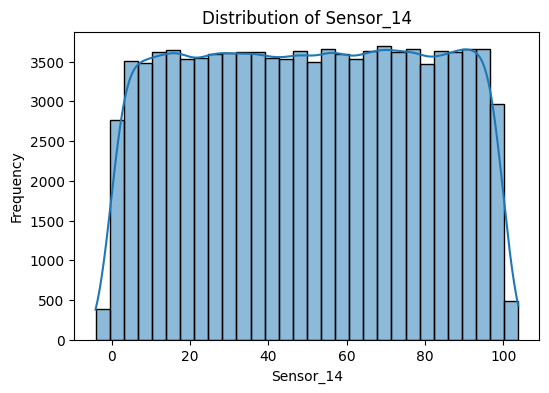

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


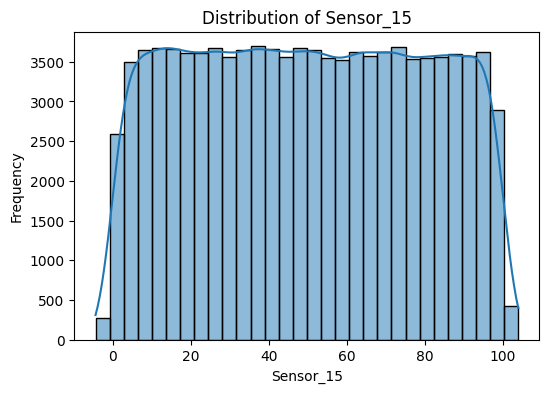

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


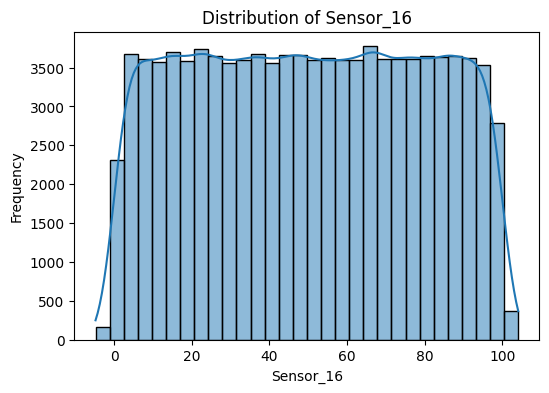

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


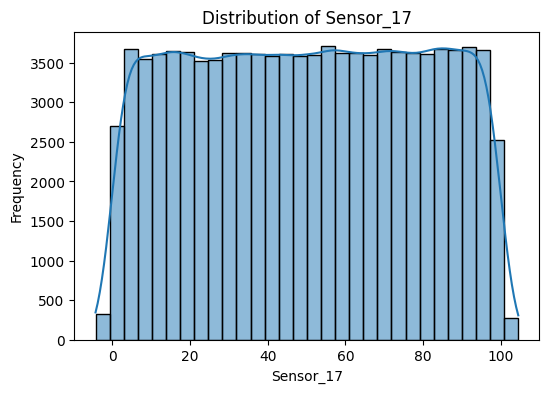

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


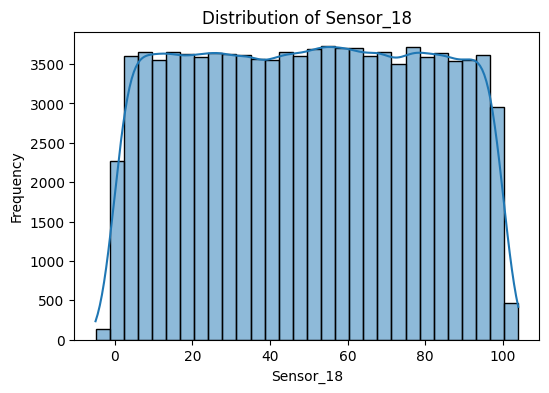

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


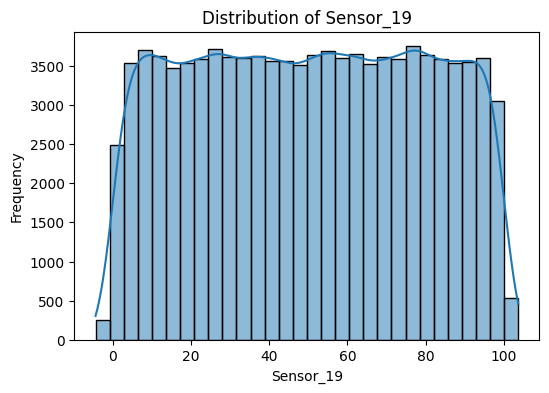

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


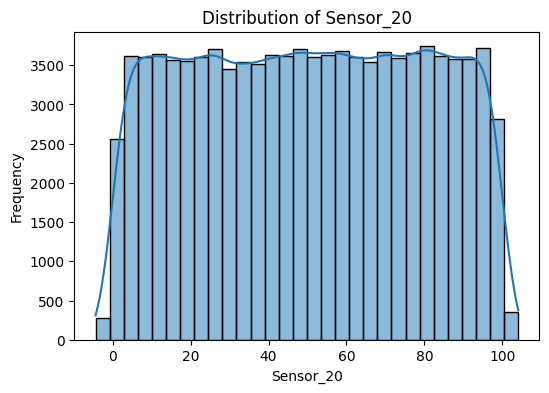

/usr/local/lib/python3.10/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


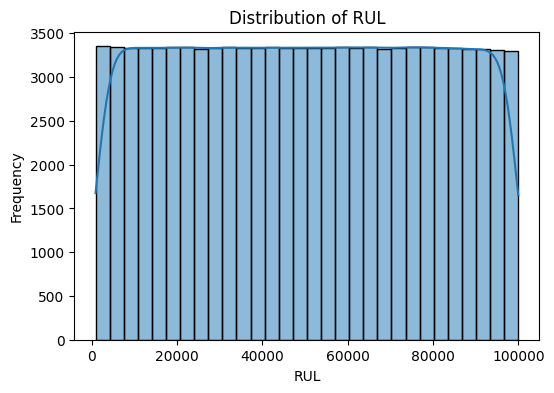

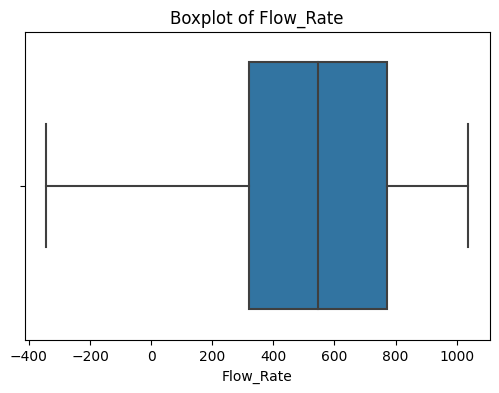

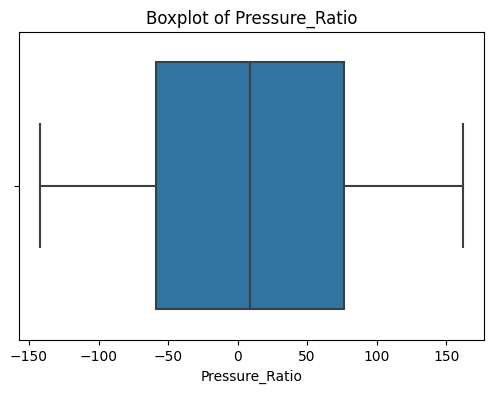

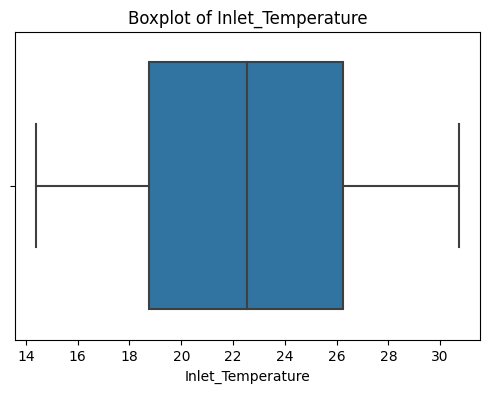

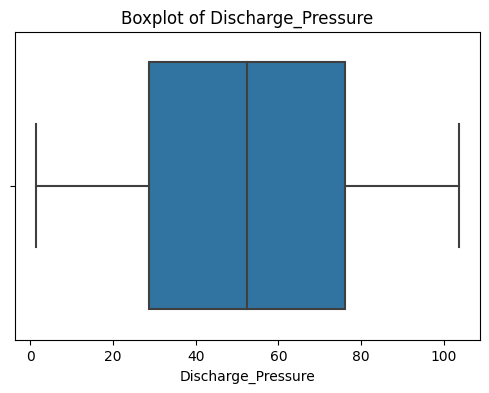

...

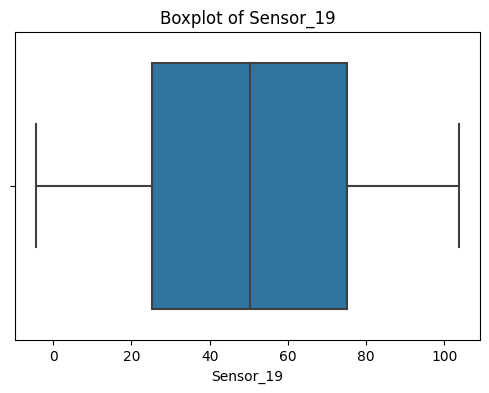

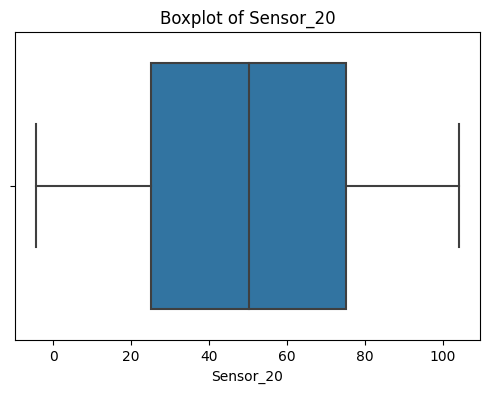

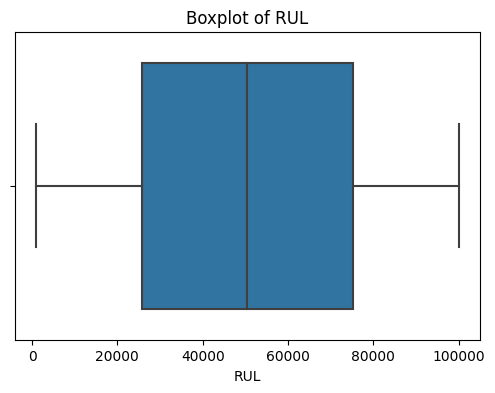

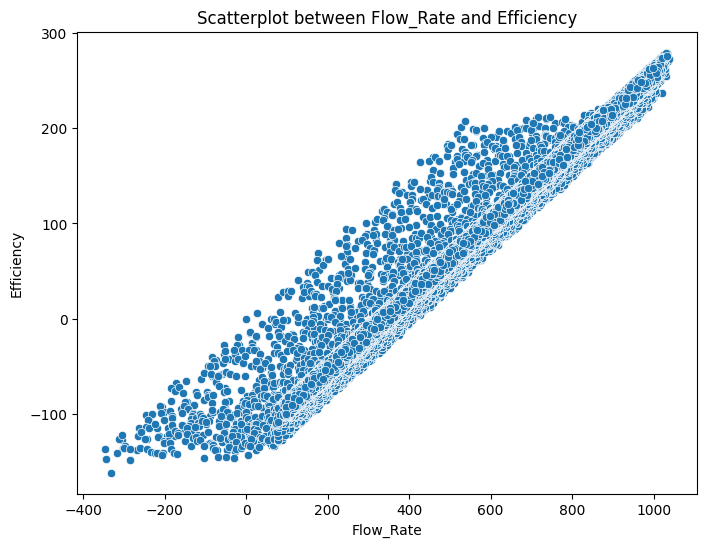

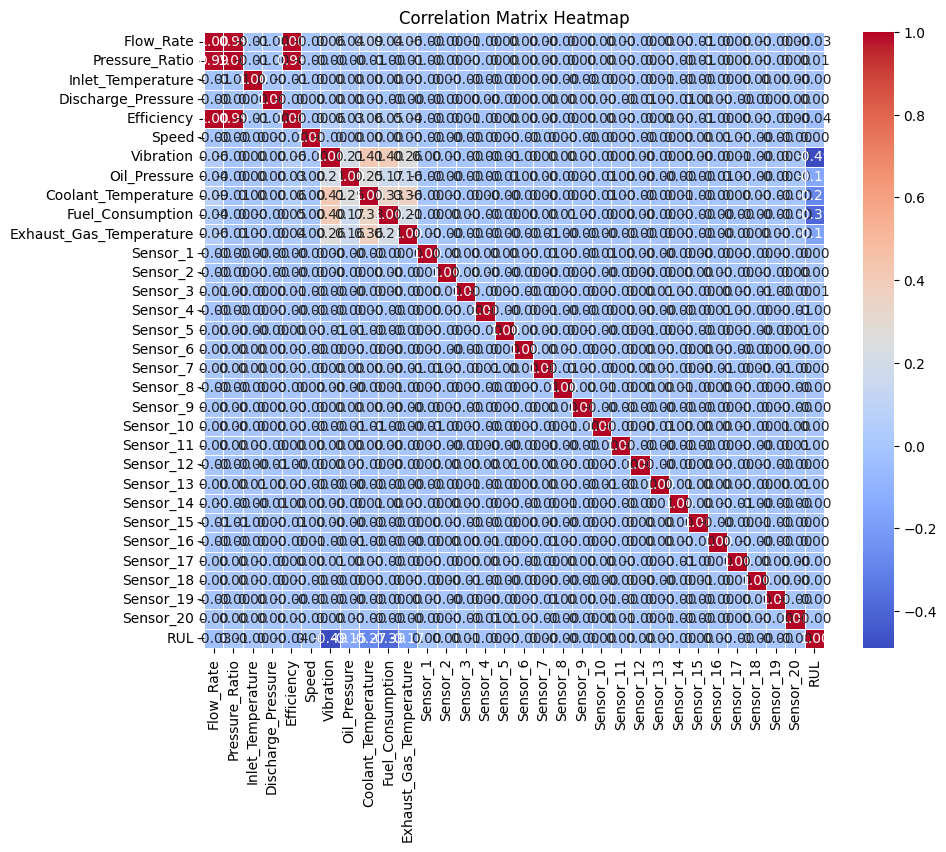


Variance Inflation Factor (VIF):
                    Feature         VIF
0                     const  326.560002
1                 Flow_Rate  128.918660
2            Pressure_Ratio  211.356199
3         Inlet_Temperature    1.000356
4        Discharge_Pressure    1.000340
5                Efficiency  313.473402
6                     Speed    1.000290
7                 Vibration    1.729849
8              Oil_Pressure    1.113393
9       Coolant_Temperature    1.905284
10         Fuel_Consumption    1.372899
11  Exhaust_Gas_Temperature    1.282936
12                 Sensor_1    1.000287
13                 Sensor_2    1.000192
14                 Sensor_3    1.000334
15                 Sensor_4    1.000261
16                 Sensor_5    1.000366
17                 Sensor_6    1.000173
18                 Sensor_7    1.000425
19                 Sensor_8    1.000326
20                 Sensor_9    1.000142
21                Sensor_10    1.000376
22                Sensor_11    1.000328
23    

In [11]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats

# Load the dataset
df = pd.read_csv('compressor_dataset_realistic_with_timestamp.csv')

# Drop 'Label' and 'Timestamp' columns
df = df.drop(columns=['Label', 'Timestamp'])

# 1. Descriptive Statistics
print("Summary Statistics:")
print(df.describe())

# 2. Distribution Visualization
for column in df.select_dtypes(include=np.number).columns:
    plt.figure(figsize=(6, 4))
    sns.histplot(df[column].dropna(), kde=True, bins=30)
    plt.title(f'Distribution of {column}')
    plt.xlabel(column)
    plt.ylabel('Frequency')
    plt.show()

# 3. Boxplot
for column in df.select_dtypes(include=np.number).columns:
    plt.figure(figsize=(6, 4))
    sns.boxplot(x=df[column].dropna())
    plt.title(f'Boxplot of {column}')
    plt.show()

# 4. Scatter Plot
plt.figure(figsize=(8, 6))
sns.scatterplot(x=df['Flow_Rate'], y=df['Efficiency'])
plt.title('Scatterplot between Flow_Rate and Efficiency')
plt.xlabel('Flow_Rate')
plt.ylabel('Efficiency')
plt.show()

# 5. Correlation Matrix Heatmap
correlation_matrix = df.corr()
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title('Correlation Matrix Heatmap')
plt.show()

# 6. Multicollinearity Check using VIF
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant

df_with_constant = add_constant(df.select_dtypes(include=np.number))
vif_data = pd.DataFrame()

vif_data['Feature'] = df_with_constant.columns
vif_data['VIF'] = [variance_inflation_factor(df_with_constant.values, i) for i in range(df_with_constant.shape[1])]

print("\nVariance Inflation Factor (VIF):")
print(vif_data)

# 7. Outlier Detection using Z-Score
z_scores = np.abs(stats.zscore(df.select_dtypes(include=np.number)))
outliers = (z_scores > 3).sum(axis=0)
print("\nNumber of outliers in each column (Z-score > 3):")
print(outliers)


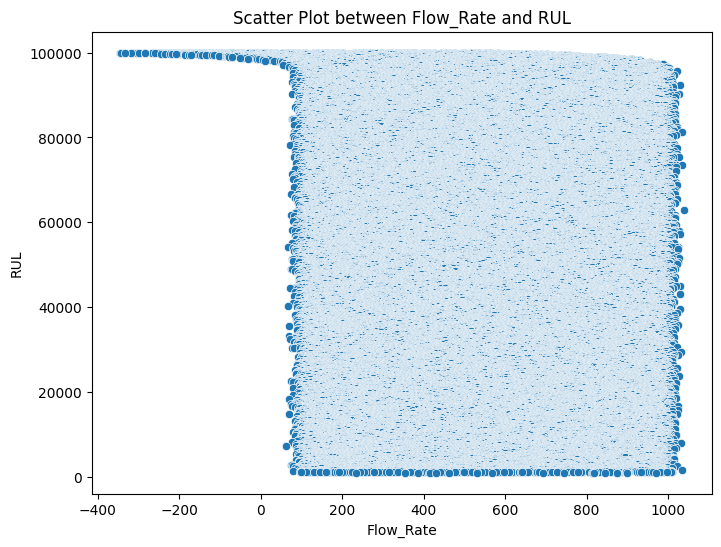

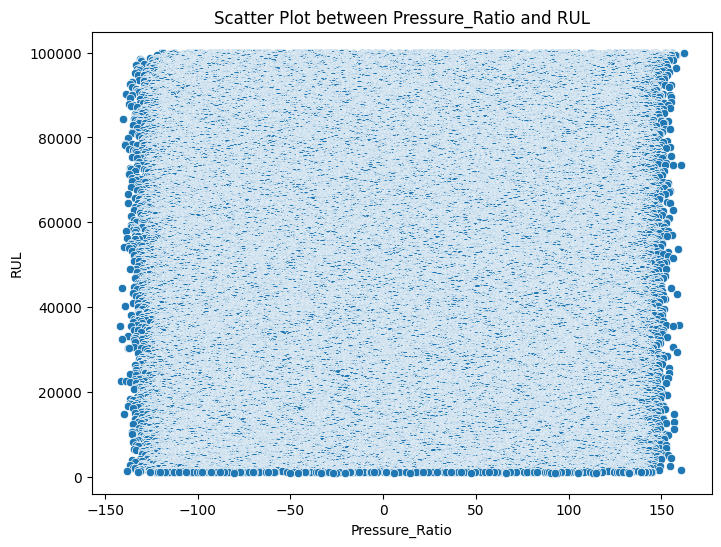

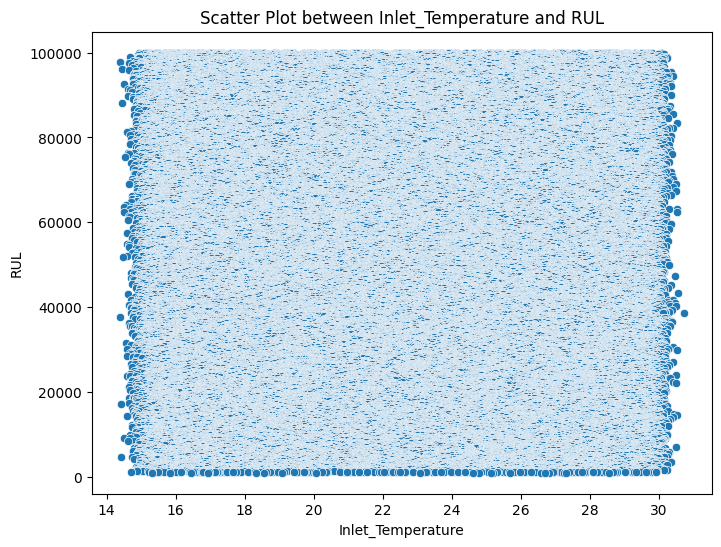

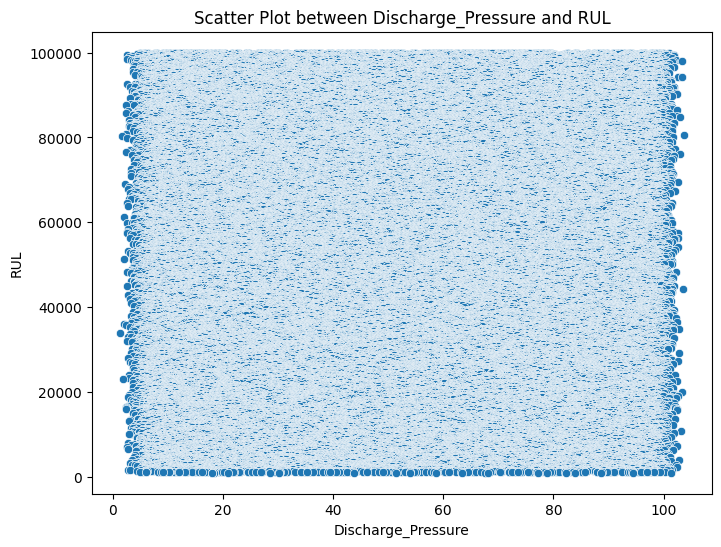

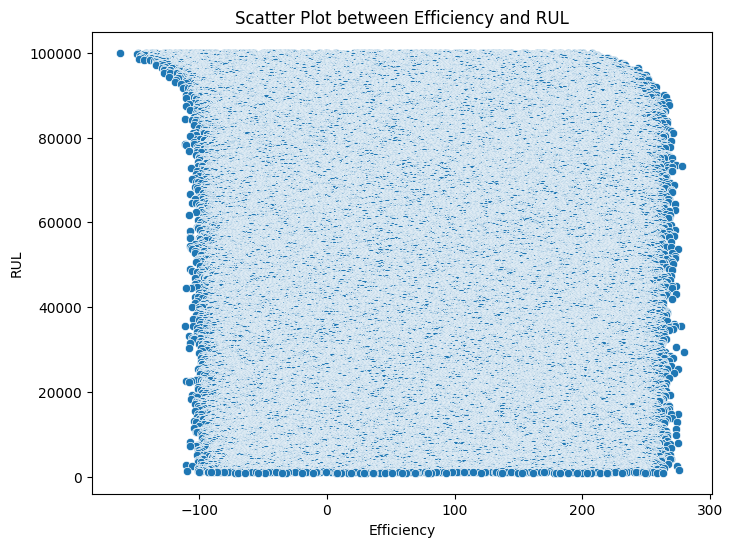

...

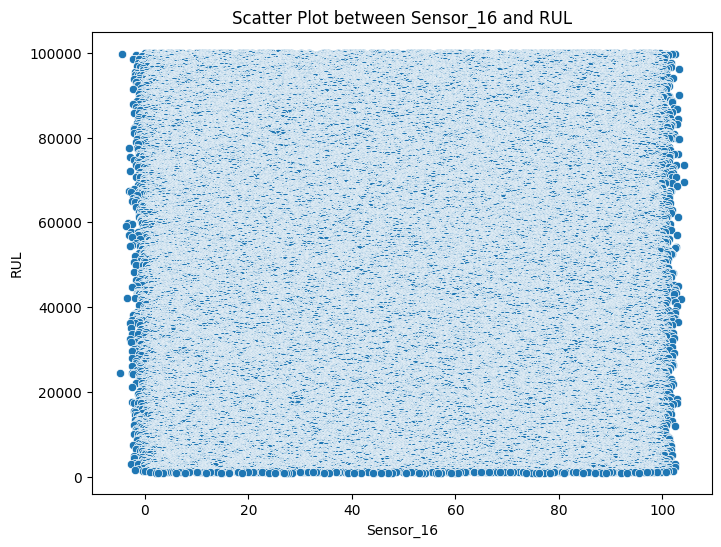

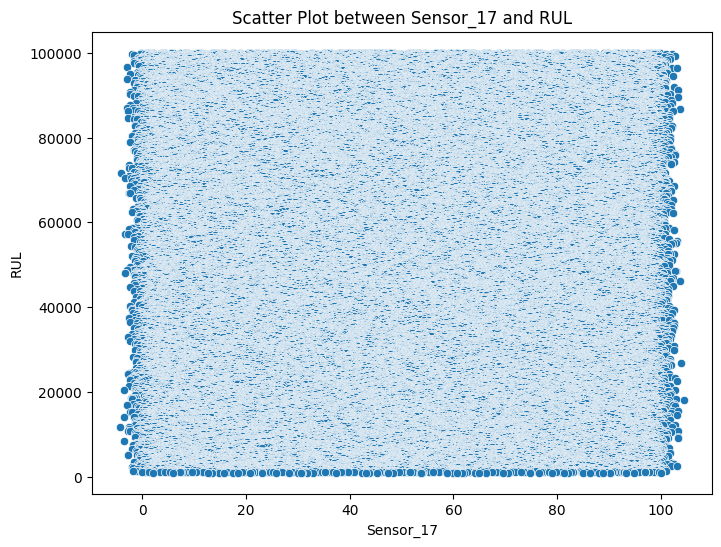

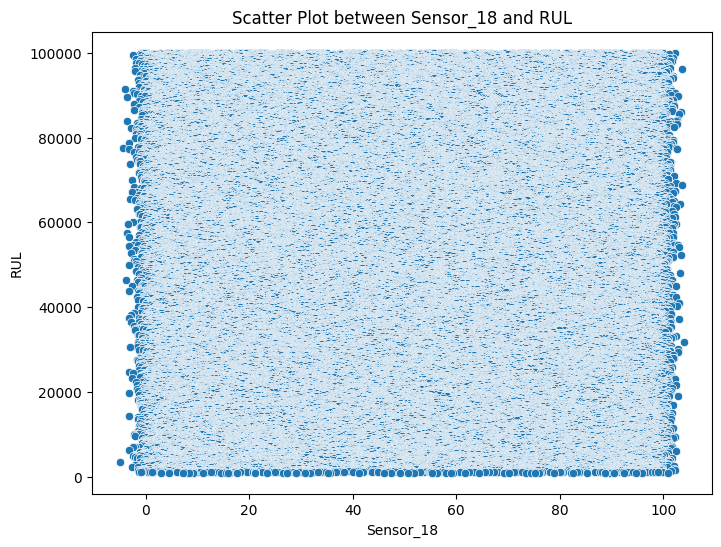

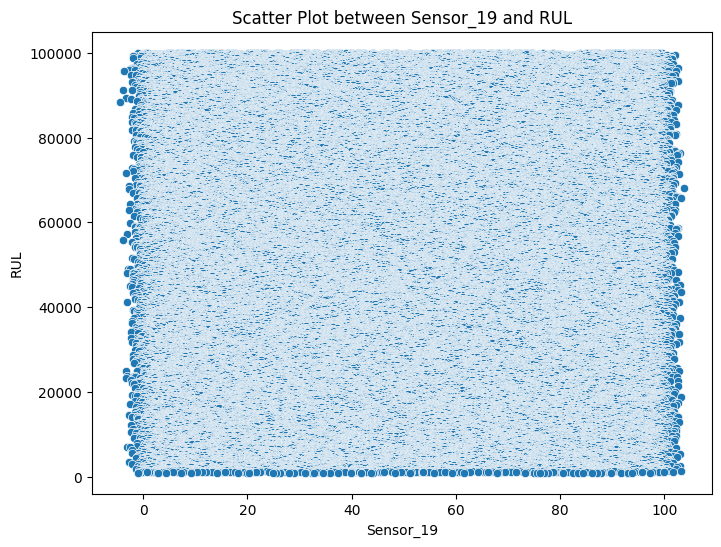

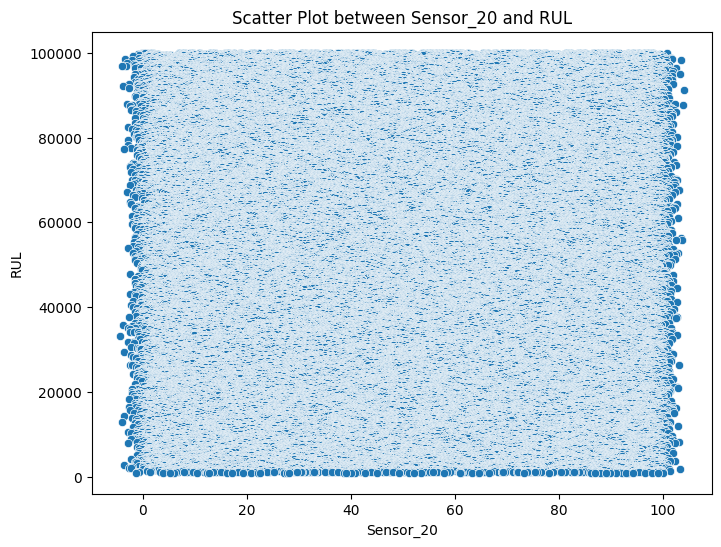

In [4]:
import matplotlib.pyplot as plt
import seaborn as sns

# Load your dataset
df = pd.read_csv('compressor_dataset_realistic_with_timestamp.csv')

# List of features (excluding 'Label' and 'Timestamp')
features = ['Flow_Rate', 'Pressure_Ratio', 'Inlet_Temperature', 'Discharge_Pressure', 
            'Efficiency', 'Speed', 'Vibration', 'Oil_Pressure', 'Coolant_Temperature', 
            'Fuel_Consumption', 'Exhaust_Gas_Temperature', 'Sensor_1', 'Sensor_2', 'Sensor_3', 
            'Sensor_4', 'Sensor_5', 'Sensor_6', 'Sensor_7', 'Sensor_8', 'Sensor_9', 'Sensor_10', 
            'Sensor_11', 'Sensor_12', 'Sensor_13', 'Sensor_14', 'Sensor_15', 'Sensor_16', 'Sensor_17', 
            'Sensor_18', 'Sensor_19', 'Sensor_20']

# Loop through each feature and plot a scatter plot with 'RUL'
for feature in features:
    plt.figure(figsize=(8,6))
    sns.scatterplot(x=df[feature], y=df['RUL'])
    plt.title(f'Scatter Plot between {feature} and RUL')
    plt.xlabel(feature)
    plt.ylabel('RUL')
    plt.show()


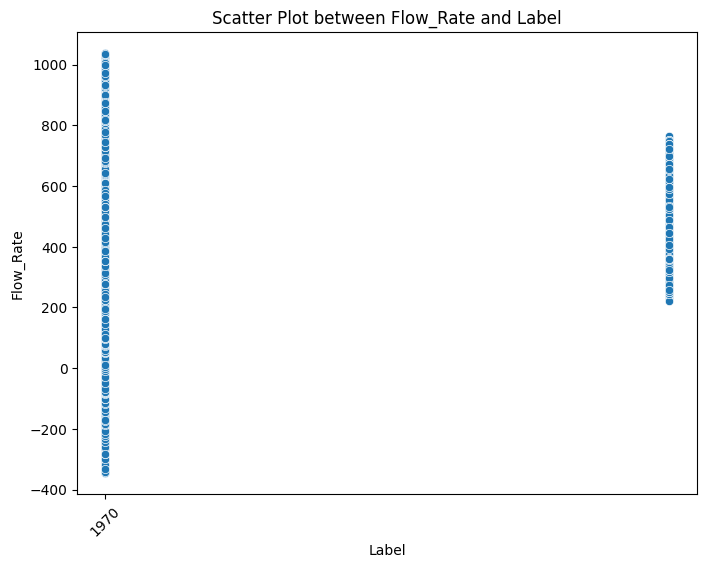

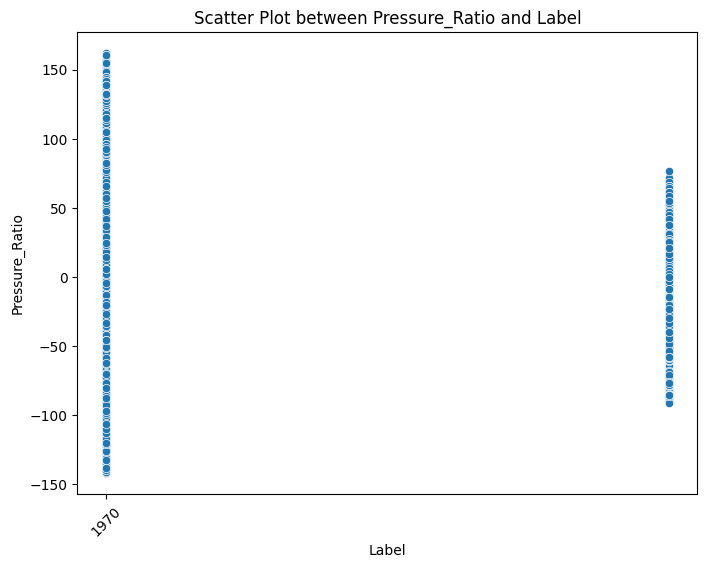

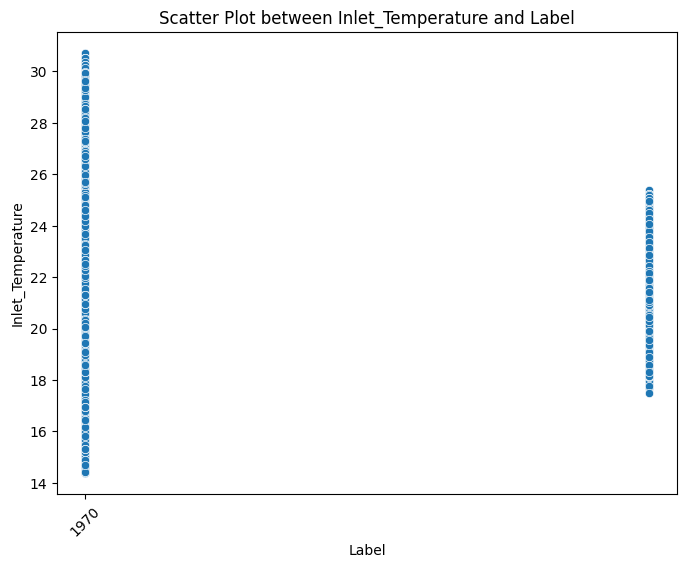

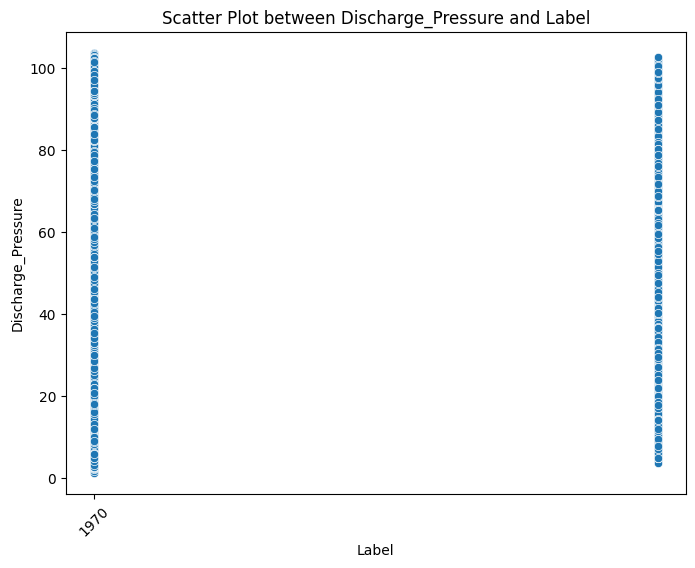

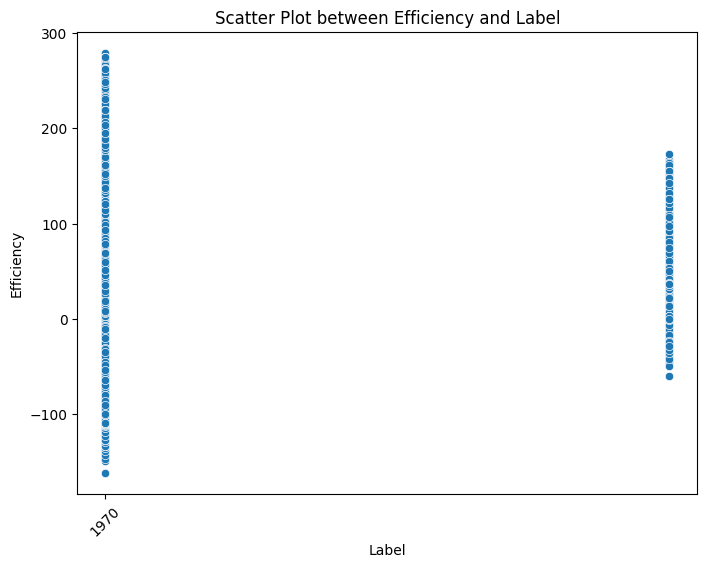

...

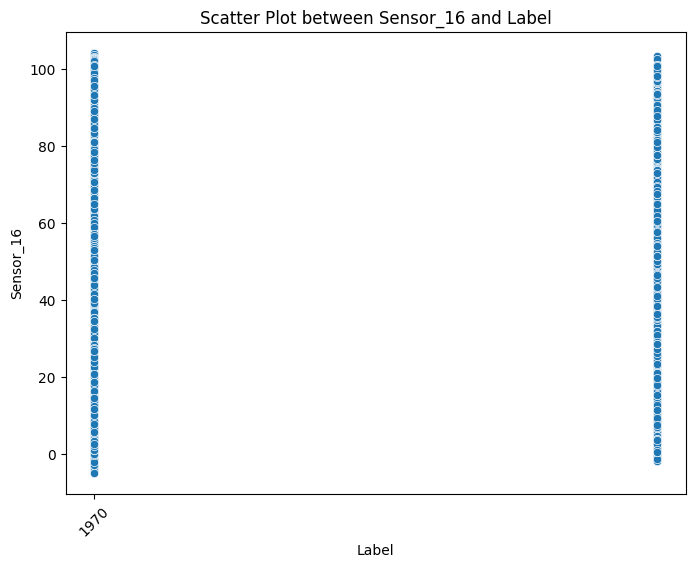

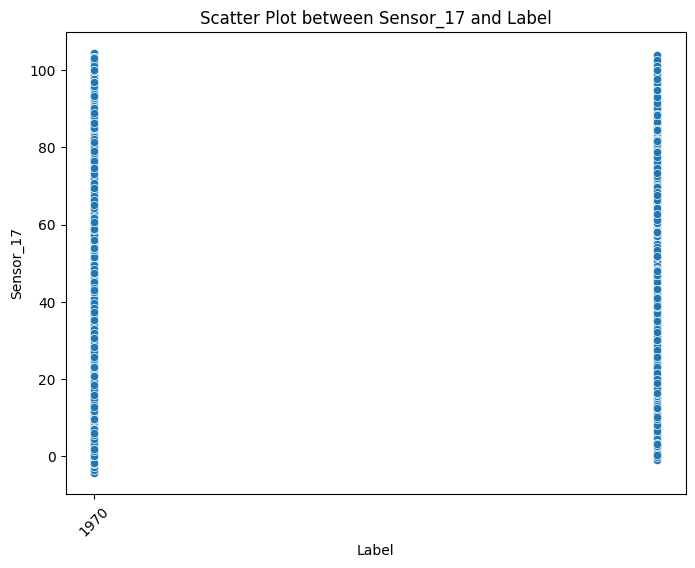

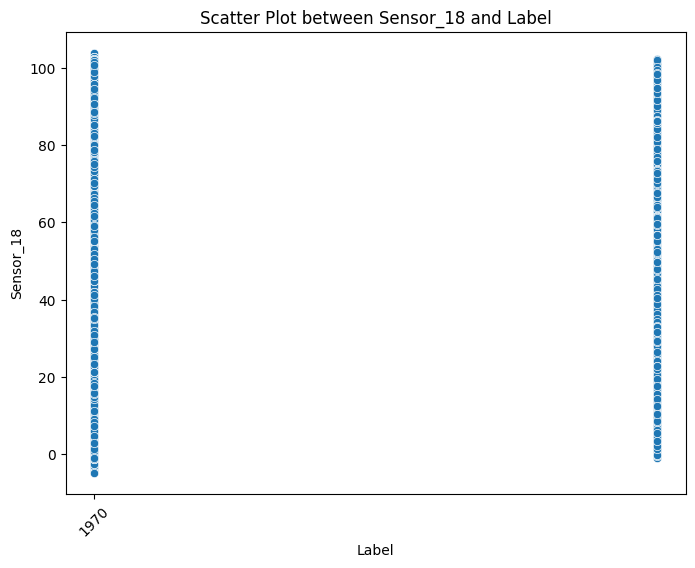

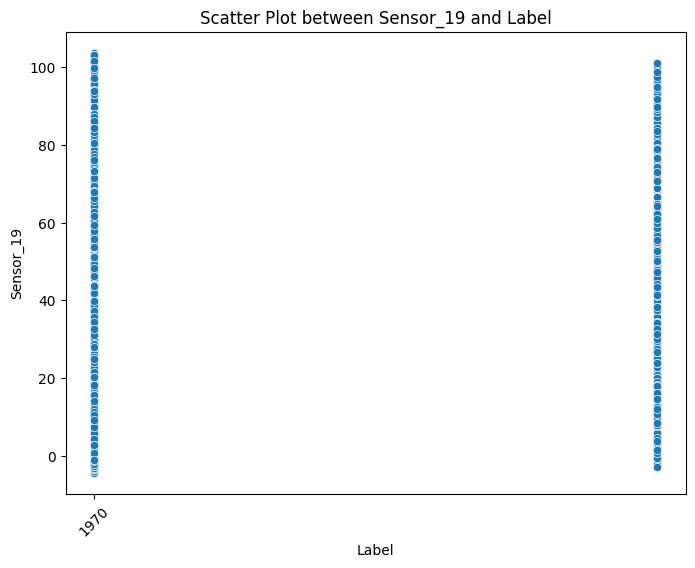

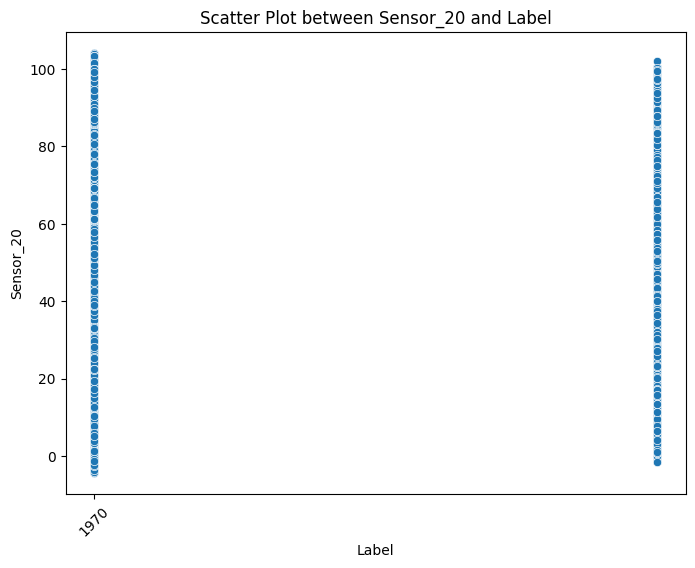

In [3]:
import matplotlib.pyplot as plt
import seaborn as sns

# Load your dataset
df = pd.read_csv('compressor_dataset_realistic_with_timestamp.csv')

# Convert 'Timestamp' column to datetime format if not already
df['Label'] = pd.to_datetime(df['Label'])

# List of features (excluding 'Label' and 'Timestamp')
features = ['Flow_Rate', 'Pressure_Ratio', 'Inlet_Temperature', 'Discharge_Pressure', 
            'Efficiency', 'Speed', 'Vibration', 'Oil_Pressure', 'Coolant_Temperature', 
            'Fuel_Consumption', 'Exhaust_Gas_Temperature', 'Sensor_1', 'Sensor_2', 'Sensor_3', 
            'Sensor_4', 'Sensor_5', 'Sensor_6', 'Sensor_7', 'Sensor_8', 'Sensor_9', 'Sensor_10', 
            'Sensor_11', 'Sensor_12', 'Sensor_13', 'Sensor_14', 'Sensor_15', 'Sensor_16', 'Sensor_17', 
            'Sensor_18', 'Sensor_19', 'Sensor_20']

# Loop through each feature and plot a scatter plot with 'Timestamp'
for feature in features:
    plt.figure(figsize=(8,6))
    sns.scatterplot(x=df['Label'], y=df[feature])
    plt.title(f'Scatter Plot between {feature} and Label')
    plt.xlabel('Label')
    plt.ylabel(feature)
    plt.xticks(rotation=45)  # Rotate x-axis labels to make them readable
    plt.show()
